In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

from utils.plotting import image_grid, plot_distribution, plot_image_grid_extremes

SEED = 5

# Directory paths
dataset_dir = Path("data/invicta_retinal_fundus")

# Load CSV dataset
dataset = pd.read_csv(dataset_dir / "dataset.csv")
dataset.set_index("id", inplace=True)
dataset["path"] = dataset["path"].apply(lambda x: dataset_dir / x)
dataset.head(10)

,dataset,modality,class,path
id,,,,
119379,eyepacs,dr,0,data/invicta_retinal_fundus/images/119379.png
27218,airogs,glaucoma,0,data/invicta_retinal_fundus/images/27218.png
184946,eyepacs,dr,0,data/invicta_retinal_fundus/images/184946.png
10766,airogs,glaucoma,1,data/invicta_retinal_fundus/images/10766.png
134958,eyepacs,dr,0,data/invicta_retinal_fundus/images/134958.png
151595,eyepacs,dr,0,data/invicta_retinal_fundus/images/151595.png
21516,airogs,glaucoma,0,data/invicta_retinal_fundus/images/21516.png
170126,eyepacs,dr,0,data/invicta_retinal_fundus/images/170126.png
74150,airogs,glaucoma,0,data/invicta_retinal_fundus/images/74150.png


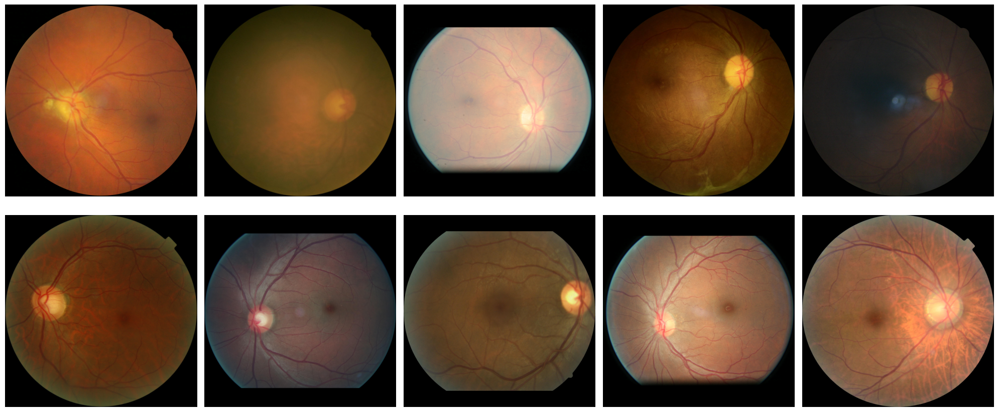

In [13]:
random_sample = dataset.sample(10, random_state=SEED)["path"].values
image_grid(random_sample, n_cols=5)
plt.show()

# Input Validation

As shown in the dataset sample, the images present in this dataset all have different characteristics. Some are slightly more in focus, others are darker and others are more colorful.

We can use **pyMDMA** metrics to quickly assess the quality of these images and what other **unannotated** concepts they contain.  
For this example, we are going to assess the *Contrast*, *Brightness*, *Sharpness*, and *Colorfulness* of the images with the help of pyMDMA.

The dataset that we are using is too large to load into memory, so we are going to use a **DataLoader** to load the images in batches:

In [14]:
from utils.data import make_dataloader
from tqdm import tqdm

fundus_dataset, image_loader = make_dataloader(
    dataset_root=dataset_dir,
    transform=None,
    batch_size=10
)

## Contrast

The **Measure of Enhancement (EME)** is a metric that can be used to measure the contrast of an image.

Source paper: https://www.researchgate.net/publication/244268659_A_New_Measure_of_Image_Enhancement

In [33]:
from pymdma.image.measures.input_val import EME

eme = EME(blocks_size=(50, 50))

dataset["contrast"] = np.nan
for batch in tqdm(image_loader):
    ids = batch["ids"]
    images = batch["images"]

    # compute contrast levels on a batch
    batch_contrast = eme.compute(images)

    # store contrast levels in the df
    instance_contrast = batch_contrast.value[1]
    dataset.loc[ids, "contrast"] = instance_contrast


100%|██████████| 1000/1000 [01:10<00:00, 14.10it/s]


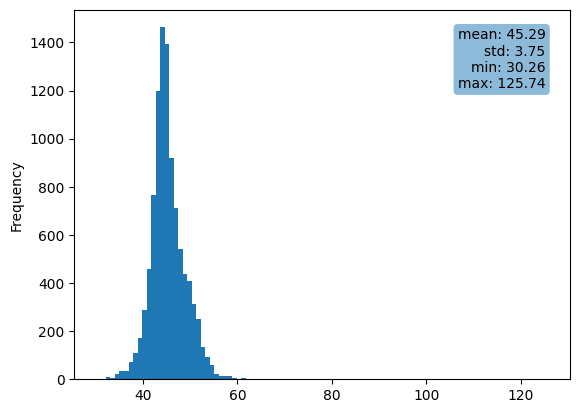

In [16]:
plot_distribution(dataset, "contrast")

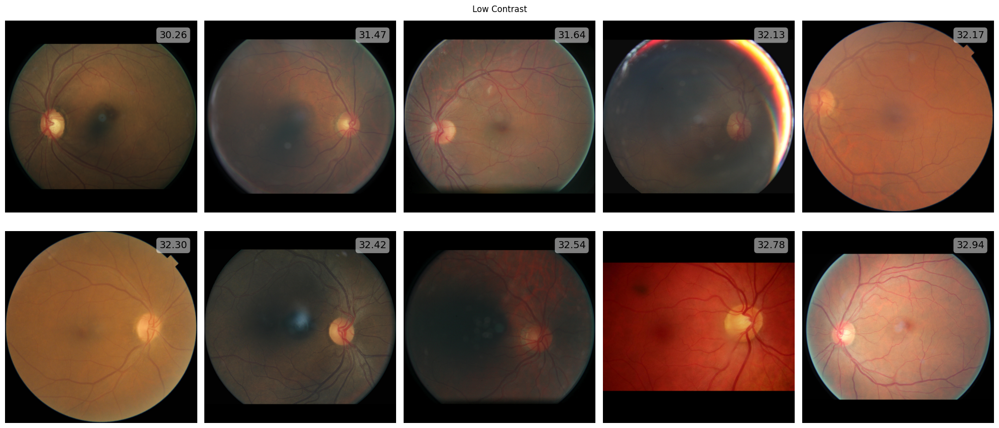

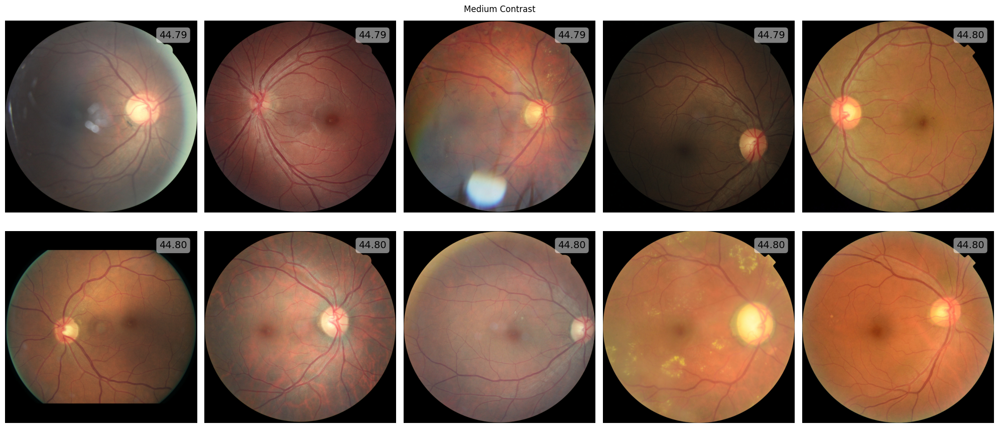

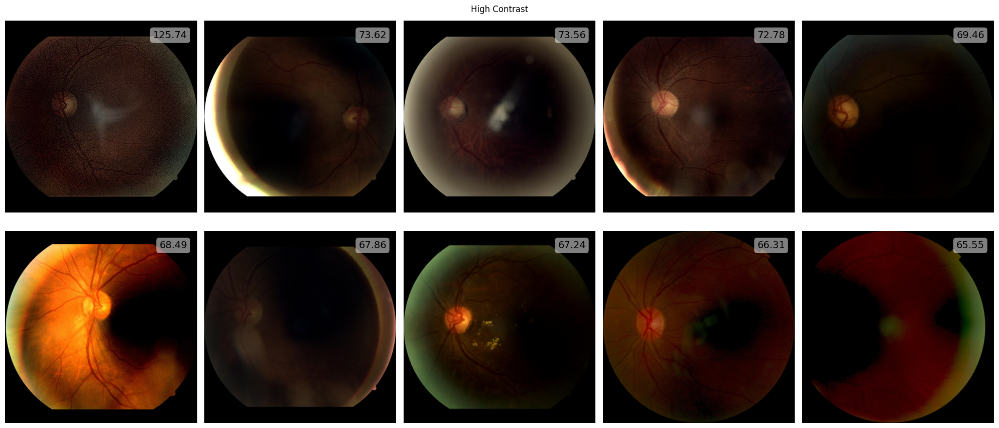

In [17]:
plot_image_grid_extremes(dataset, "contrast")

# Brightness

In [18]:
from pymdma.image.measures.input_val import Brightness

bright = Brightness()

dataset["brightness"] = np.nan
for batch in tqdm(image_loader):
    ids = batch["ids"]
    images = batch["images"]

    # compute contrast levels on a batch
    batch_bright = bright.compute(images)

    # store contrast levels in the df
    instance_bright = batch_bright.value[1]
    dataset.loc[ids, "brightness"] = instance_bright


100%|██████████| 1000/1000 [00:49<00:00, 20.23it/s]


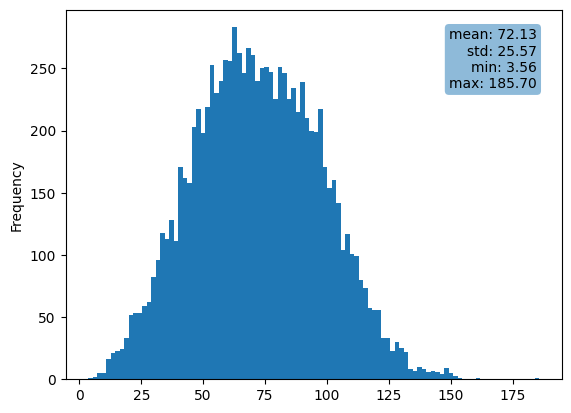

In [19]:
plot_distribution(dataset, "brightness")

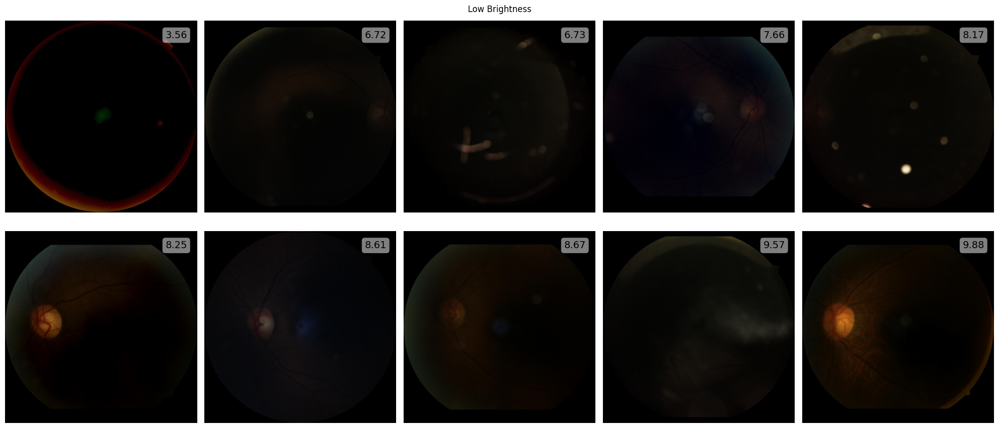

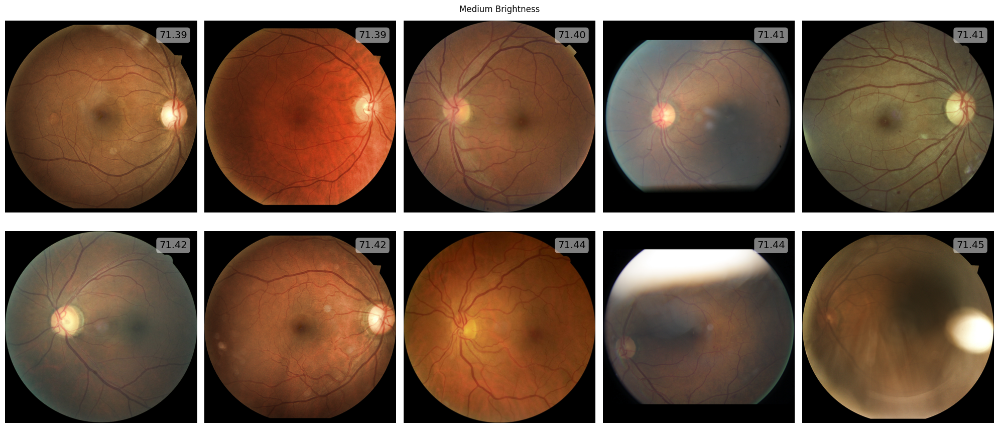

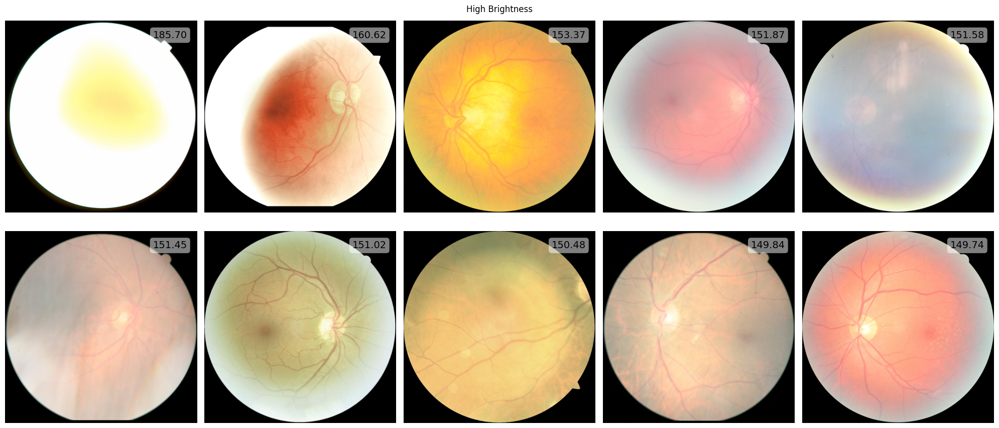

In [20]:
plot_image_grid_extremes(dataset, "brightness")

# Sharpness

In [21]:
from pymdma.image.measures.input_val import Tenengrad

tene = Tenengrad()

dataset["sharpness"] = np.nan
for batch in tqdm(image_loader):
    ids = batch["ids"]
    images = batch["images"]

    # compute contrast levels on a batch
    batch_tene = tene.compute(images)

    # store contrast levels in the df
    instance_tene = batch_tene.value[1]
    dataset.loc[ids, "sharpness"] = instance_tene


100%|██████████| 1000/1000 [01:04<00:00, 15.53it/s]


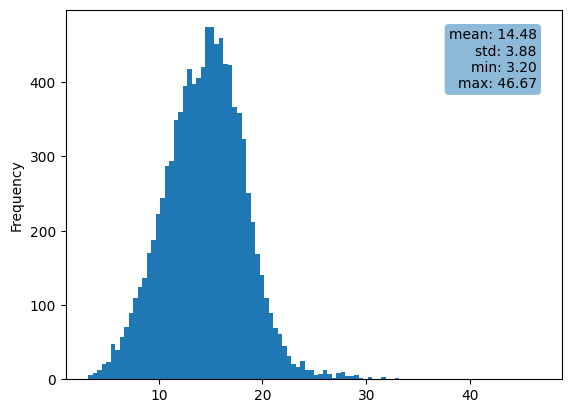

In [22]:
plot_distribution(dataset, "sharpness")

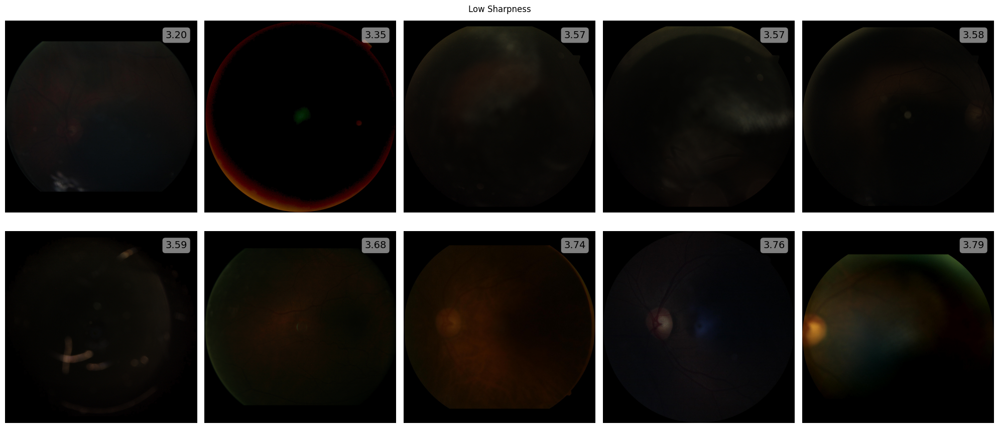

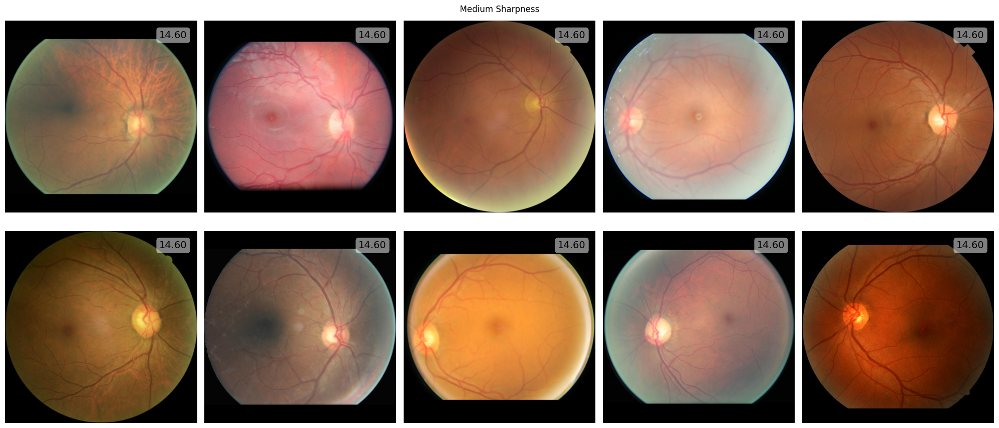

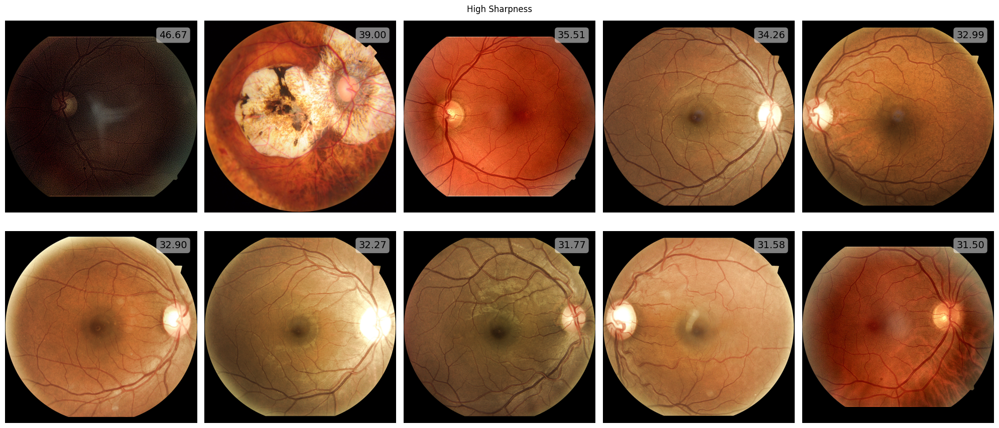

In [23]:
plot_image_grid_extremes(dataset, "sharpness")

# Colorfulness

In [25]:
from pymdma.image.measures.input_val import Colorfulness

colorfulness = Colorfulness()

dataset["colorfulness"] = np.nan
for batch in tqdm(image_loader):
    ids = batch["ids"]
    images = batch["images"]

    # compute contrast levels on a batch
    batch_color = colorfulness.compute(images)

    # store contrast levels in the df
    instance_color = batch_color.value[1]
    dataset.loc[ids, "colorfulness"] = instance_color


100%|██████████| 1000/1000 [01:01<00:00, 16.28it/s]


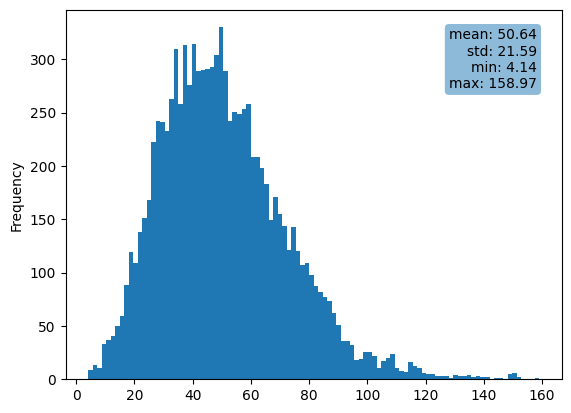

In [26]:
plot_distribution(dataset, "colorfulness")

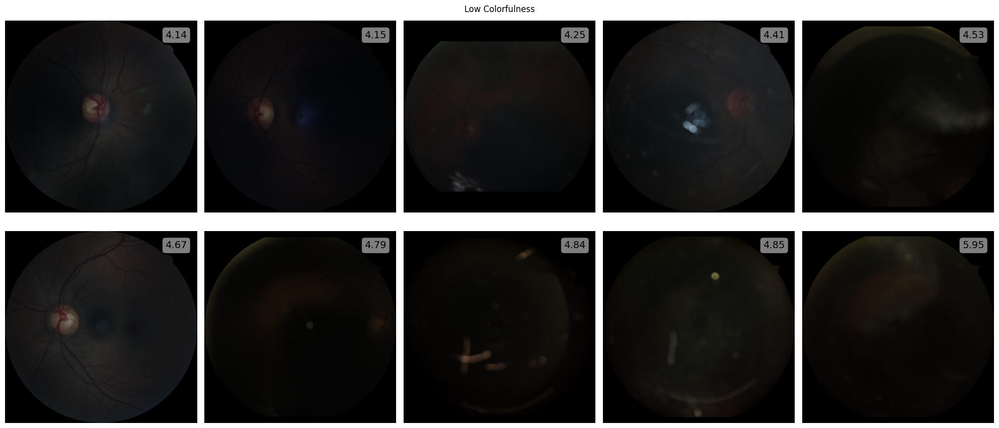

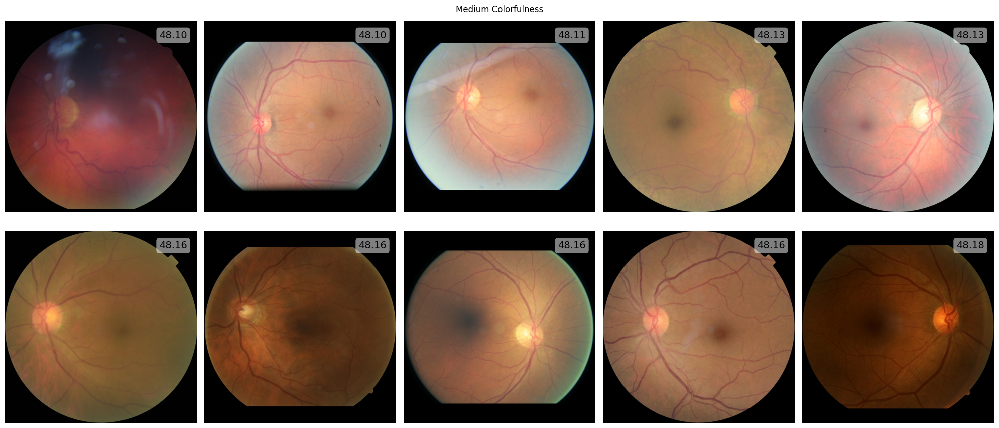

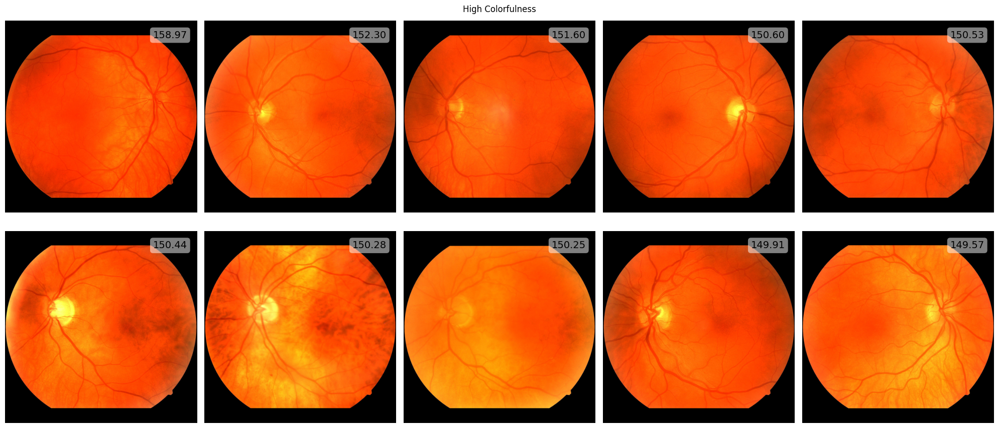

In [27]:
plot_image_grid_extremes(dataset, "colorfulness")

# Wrapping Up

In [30]:
dataset.describe().drop(["class"], axis=1)

,contrast,brightness,sharpness,relative_sharpness,colorfulness
count,10000.000000,10000.000000,10000.000000,720.000000,10000.000000
mean,45.285275,72.132601,14.476205,0.848128,50.644416
std,3.754492,25.567335,3.883298,0.039027,21.594443
min,30.261487,3.560163,3.197564,0.708236,4.135237
25%,43.118928,53.613671,11.894837,0.822638,34.917448
50%,44.796098,71.415131,14.600287,0.847930,48.145916
75%,47.218373,90.551214,17.017359,0.873407,63.313619
max,125.738921,185.697784,46.670592,0.953507,158.967926


In [ ]:
# dataset["path"] = dataset["path"].apply(lambda x: x.parent.name + "/" + x.name)
dataset.to_csv(dataset_dir / "input_validation.csv")